# SNA Project#3 - Networking and Community Analysis 

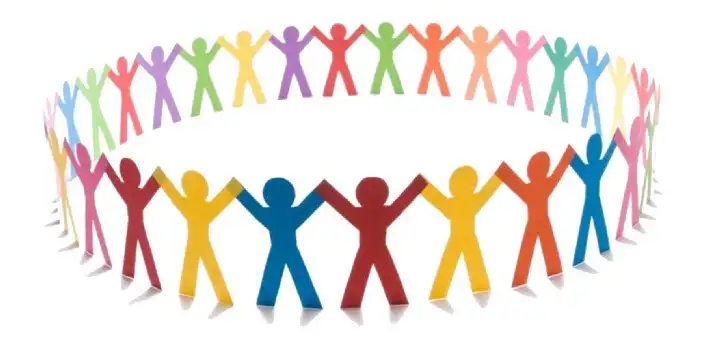

image from https://stangarfield.medium.com/what-is-the-difference-between-a-community-of-practice-and-a-social-network-bcd1af362eca

## Overview

- Data Acquisition
- Data Exploring 
- Network Exploring 
- Modeling
    - Segmentation & Similarity
    - Centrality 
    - Community 
    - Location Visualization
    - Profile Clustering 
- Post Analysis 

In [98]:
from community import community_louvain
from datetime import datetime, timedelta

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import networkx.algorithms.community as nx_comm
import matplotlib.cm as cm
import seaborn as sns


%matplotlib inline
pd.set_option('display.max_colwidth', 120)

In [3]:
!ls data-project1/

follower_network.csv output_tweet.csv     top_tweet_agents.csv


# Data Acquisition

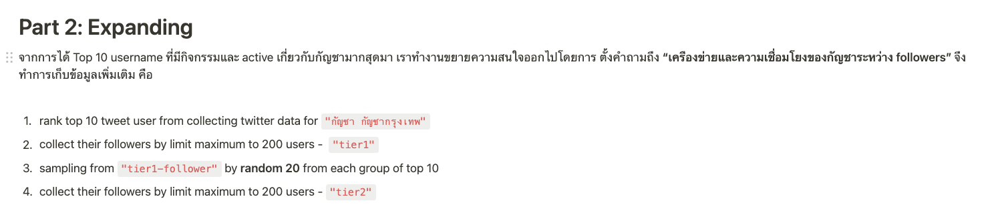

user/account = node

follower => in-degree

following => out-degre

In [4]:
fol_df=pd.read_csv('data-project1/follower_network.csv')

# Exploratory Data Analysis

In [58]:
fol_df.dtypes

source_id         int64
source_name      object
follower_name    object
follower_id       int64
location         object
description      object
dtype: object

In [21]:
fol_df.columns

Index(['source_id', 'source_name', 'follower_name', 'follower_id', 'location',
       'description'],
      dtype='object')

In [20]:
fol_df.head()

,source_id,source_name,follower_name,follower_id,location,description
0,1554768110963478528,42xWeeD,C9xMggNjYe4e6GI,1396605027532238848,NaN,NaN
1,1554768110963478528,42xWeeD,Benz23625920,1351745154344919042,NaN,NaN
2,1554768110963478528,42xWeeD,Doy1237,1417122611482427395,NaN,NaN
3,1554768110963478528,42xWeeD,HighBerHerb420,1568813694355918848,"Bangkok, Thailand","Cannabis shop \nExotic, Top-shelf, mid-grade,low-grade\nส่ง+50฿"
4,1554768110963478528,42xWeeD,phlab_thxng,1571090237526536193,NaN,NaN


In [49]:
fol_df[['source_id','follower_id']].drop_duplicates().shape

(9581, 2)

In [51]:
fol_df=fol_df.drop_duplicates()

In [101]:
source_df=fol_df['source_id'].drop_duplicates()
follow_df=fol_df['follower_id'].drop_duplicates()

In [104]:
source_df.shape, follow_df.shape

((172,), (7559,))

In [894]:
fol_df['source_name'].value_counts().reset_index().rename(columns={'index':'source_name', 'source_name': 'follower_count'})

,source_name,follower_count
0,Boy72323239,200
1,greenyard4420,200
2,ZC8EbZI8zsdKnGQ,200
3,senelux1,200
4,tntn60417683,200
...,...,...
167,Lp9Ob,1
168,cZ2uo91LnUvCNUy,1
169,mickcobain,1
170,fxckyahhh,1


In [896]:
fol_df[fol_df['source_name']=='Boy72323239'].head()

,source_id,source_name,follower_name,follower_id,location,description
7258,1536602206803152896,Boy72323239,zonozeno,1213716591902199809,"อุดรธานี, ประเทศไทย",รุก ภายนอก เอ้าท์ดอ ป๊อป
7259,1536602206803152896,Boy72323239,Tzivya48456758,1567058064498384896,NaN,NaN
7260,1536602206803152896,Boy72323239,khxlln48472732,1568873755442806785,NaN,NaN
7261,1536602206803152896,Boy72323239,Top83619507,1563050512651808768,NaN,NaN
7262,1536602206803152896,Boy72323239,bLhIw9GdUf4IJST,1551938454682218496,NaN,NaN


In [897]:
fol_df['follower_name'].value_counts().reset_index().rename(columns={'index':'follower_name', 'follower_name': 'following_count'})

,follower_name,following_count
0,greenyard4420,82
1,THELEGENDOFFIC,39
2,Stoner__Weed,38
3,Seven9z,31
4,3hzee,29
...,...,...
7554,cenn10432276,1
7555,knnh54630247,1
7556,NormalinF,1
7557,Na_3443,1


In [898]:
fol_df[fol_df['follower_name']=='THELEGENDOFFIC'].head()

,source_id,source_name,follower_name,follower_id,location,description
1036,1559885381654327297,420weedog,THELEGENDOFFIC,1568867553661046785,NaN,welcome to world of organic Cannabis 🌱💯 ยินดีต้อนรับสู่โลกของกัญ 🌱💯
1411,1554807255530614784,webballstep12,THELEGENDOFFIC,1568867553661046785,NaN,welcome to world of organic Cannabis 🌱💯 ยินดีต้อนรับสู่โลกของกัญ 🌱💯
1567,1564506774572781568,OneNightStoned,THELEGENDOFFIC,1568867553661046785,NaN,welcome to world of organic Cannabis 🌱💯 ยินดีต้อนรับสู่โลกของกัญ 🌱💯
1577,1550589052227035136,vickynamtarn,THELEGENDOFFIC,1568867553661046785,NaN,welcome to world of organic Cannabis 🌱💯 ยินดีต้อนรับสู่โลกของกัญ 🌱💯
1790,1526922944240562177,suphathrmicice2,THELEGENDOFFIC,1568867553661046785,NaN,welcome to world of organic Cannabis 🌱💯 ยินดีต้อนรับสู่โลกของกัญ 🌱💯


In [899]:
# fol_df.groupby(['follower_id']).count().sort_values('source_id', ascending=False).reset_index()[['follower_id','source_id']].rename(columns={'source_id':'following_count'})
# follower_count_df=fol_df.groupby('source_id').count().sort_values('follower_name', ascending=False).reset_index()[['source_id','follower_name']].rename(columns={'source_id':'account_id','follower_name':'follower_count'})
# following_count_df=fol_df.groupby(['follower_id']).count().sort_values('source_id', ascending=False).reset_index()[['follower_id','source_id']].rename(columns={'follower_id':'account_id','source_id':'following_count'})

In [900]:
follower_count_df=fol_df['source_name'].value_counts().reset_index().rename(columns={'index':'account_name', 'source_name':'follower_count'})
following_count_df=fol_df['follower_name'].value_counts().reset_index().rename(columns={'index':'account_name', 'follower_name': 'following_count'})

In [901]:
# visual behaviour of user

In [902]:
follower_count_df.shape, following_count_df.shape

((172, 2), (7559, 2))

In [903]:
df3=pd.merge(following_count_df, follower_count_df, how="outer", on=["account_name"]).fillna(0)

In [906]:
# **คนขาย** behaviour ที่โดดเด่น ไม่เกรงใจใคร...
df3[(df3['follower_count']==df3['follower_count'].max()) & (df3['following_count']==df3['following_count'].min())].reset_index(drop=True)

,account_name,following_count,follower_count
0,BooK_Ku,0.0,200.0
1,GUEST6607526277,0.0,200.0
2,nkx8yf4PxV8RccU,0.0,200.0
3,smokequeen89,0.0,200.0


In [907]:
fol_df[fol_df['source_name']=='BooK_Ku'].head()

,source_id,source_name,follower_name,follower_id,location,description
65,63018215,BooK_Ku,Sweeddyshopv2,1567111030568001536,NaN,💎 Premium Product High Quality 💎\n\nline 📲 https://t.co/Q4Sy87ZwGC\n\n#Exotic #TopShelf 🏆\n\n🛫 จัดส่งทั่วโลก 🛫\n\nกท...
66,63018215,BooK_Ku,littlepigw,3181919426,NaN,NaN
67,63018215,BooK_Ku,WangmanowOg,1566205717433835520,"Bangkok Noi, Bangkok","🥦ดอกไม้ ราคาปลีก-ส่ง❗❗\n\n👉 Top shelf, 👉 Exotic 🇹🇭 Thai Fram \n\nมีเครดิตเช็คได้ DM ✉️ มาเลยครับ"
68,63018215,BooK_Ku,Anne82673743,1564419363775848448,NaN,NaN
69,63018215,BooK_Ku,S_K_Y_S_K,1142008929477517313,NaN,ผู้ชาย


In [908]:
df3['abs_diff']=abs(df3['following_count']-df3['follower_count'])

In [909]:
# what we observe top 10
df3.sort_values('abs_diff', ascending=False)[:10]

,account_name,following_count,follower_count,abs_diff
7562,smokequeen89,0.0,200.0,200.0
7561,nkx8yf4PxV8RccU,0.0,200.0,200.0
7560,GUEST6607526277,0.0,200.0,200.0
7559,BooK_Ku,0.0,200.0,200.0
5171,tntn60417683,1.0,200.0,199.0
5647,Boy72323239,1.0,200.0,199.0
5000,soju1420,1.0,200.0,199.0
5188,Abcdefghij3344,1.0,200.0,199.0
3840,tuatoh29,1.0,200.0,199.0
5487,SoRo_Z,1.0,200.0,199.0


### Location analysis

In [74]:
# 31% that tell(open) thier location
(fol_df[~fol_df['location'].isnull()].shape[0])*100/fol_df.shape[0]

31.009289218244444

In [90]:
loc_df=fol_df[~fol_df['location'].isnull()].drop_duplicates()

In [501]:
loc_df[['location']].drop_duplicates()

,location
3,"Bangkok, Thailand"
6,ประเทศไทย
10,Pathum
20,Amphoe Mueang Nakhon Sawan
22,LA
...,...
10147,"อ.นางรอง, จ.บุรีรัมย์"
10186,Jurupa Valley
10189,"اسلام آباد G9/2, Pakistan"
10190,🇵🇰~🇰🇼


In [97]:
# visual location

In [510]:
loc_df['location'].tolist()

['Bangkok, Thailand',
 'ประเทศไทย',
 'Pathum',
 'Amphoe Mueang Nakhon Sawan',
 'LA',
 'Bangkok, Thailand',
 'นนทบุรี, ประเทศไทย',
 'Rayong, Thailand',
 'Bangkok, Thailand',
 'กรุงเทพมหานคร, ประเทศไทย',
 'Thailand',
 'อ.หนองไผ่, จ.เพชรบูรณ์',
 'สมุทรปราการ',
 'นนทบุรี',
 'อ.เมืองนครราชสีมา, จ.นครราชสีม',
 'จ.สระบุรี, ประเทศไทย',
 'Bangkok Noi, Bangkok',
 'Nakhon Si Thammarat, Thailand',
 'ขุขันธ์',
 'กทม',
 'อ.เมืองภูเก็ต, จ.ภูเก็ต',
 'บนหัวใครสักคนที่รู้สึกหนักๆ',
 'สมุทรปราการ, ประเทศไทย',
 'Bangkok, Thailand',
 'ร้านกาแฟในตรอกไดแอกอน',
 'Thailand',
 'นครราชสีมา, ประเทศไทย',
 'ศรีสะเกษ',
 'กรุงเทพมหานคร, ประเทศไทย',
 'Rasi Salai, Thailand',
 'Bangkok, Thailand',
 'Bang Khen, Bangkok',
 'Chon Buri Province, Thailand',
 'อ.ศรีราชา, จ.ชลบุรี',
 'กาญจนบุรี, ประเทศไทย เขาชนไก่',
 'ทุ่งครุ, กรุงเทพมหานคร',
 'สระแก้ว',
 'Bangkok, Thailand',
 'อ.เมืองสมุทรสาคร, จ.สมุทรสาคร',
 'Chiang Mai, Thailand',
 'Yannawa, Bangkok',
 'อ.โชคชัย, จ.นครราชสีมา',
 'Si Sa Ket, Thailand',
 'Phone +66 169 696 77

### Description analysis

In [94]:
# 56% that tell(add) thier description
(fol_df[~fol_df['description'].isnull()].shape[0])*100/fol_df.shape[0]

55.850120029224506

In [95]:
desc_df=fol_df[~fol_df['description'].isnull()].drop_duplicates()

In [149]:
desc_df.shape

(5351, 6)

In [89]:
# visual desc_df

In [512]:
# desc_df

# Network EDA

In [17]:
G=nx.from_pandas_edgelist(fol_df, 'source_name', 'follower_name') 

In [18]:
# number of nodes in network
G.number_of_nodes()

7566

In [19]:
# number of edges in network
G.number_of_edges()

9554

In [108]:
fol_df['source_id'].count()

9581

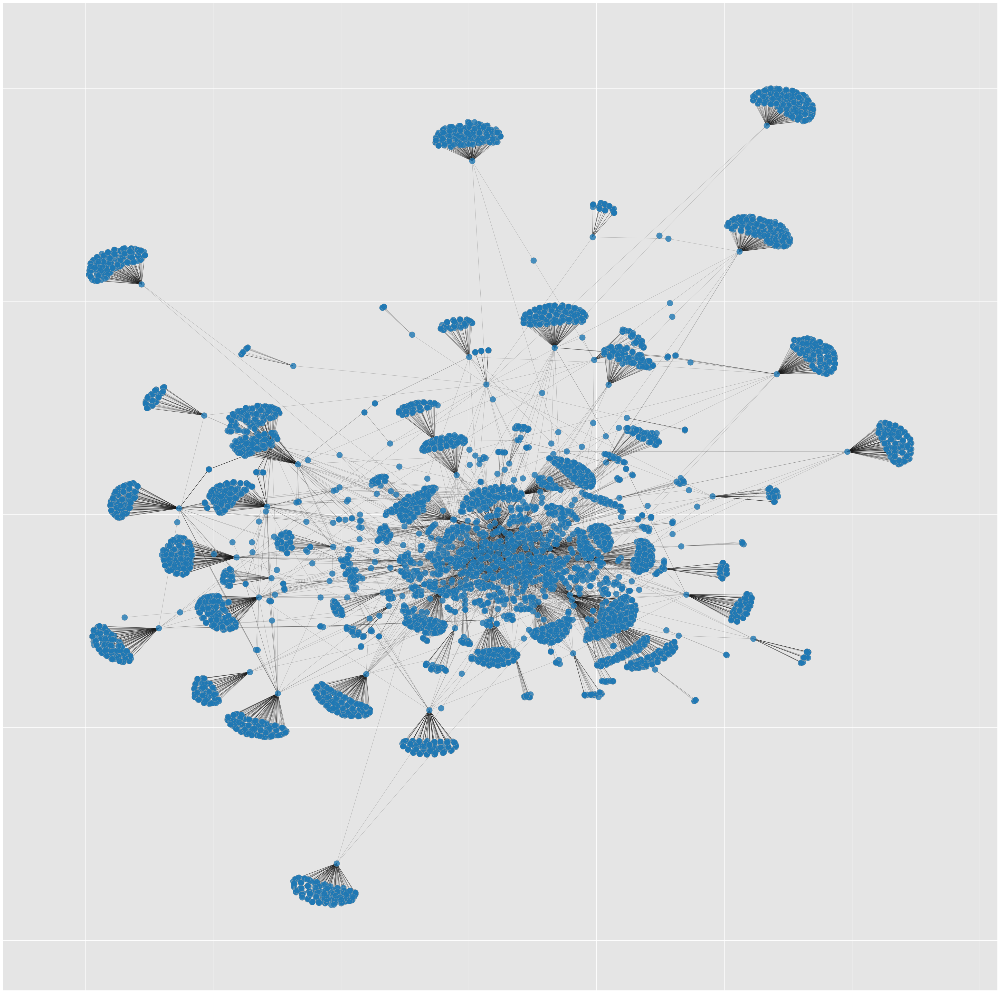

In [877]:
pos = nx.spring_layout(G) 
f, ax = plt.subplots(figsize=(50, 50))
plt.style.use('ggplot')
nodes = nx.draw_networkx_nodes(G, pos, alpha=0.8)

nodes.set_edgecolor('#AAAAAA')
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.2)

### build network

In [380]:
def create_network (temp_df , node_name):
    # create graph from edges
    temp_df=temp_df[temp_df["source_name"] == node_name][["source_name","follower_name"]]

    G=nx.from_pandas_edgelist(temp_df, "source_name", "follower_name")
    hub_ego = nx.ego_graph(G, node_name)
    pos = nx.spring_layout(hub_ego)  
    nx.draw(hub_ego, 
            pos, 
            node_color="b", 
            node_size=50,
            with_labels=True, 
            font_size=7,
            alpha=.7)
    options = {"node_size": 300, "node_color": "r"}
    nx.draw_networkx_nodes(hub_ego, pos, nodelist=[node_name], **options)
    plt.show()

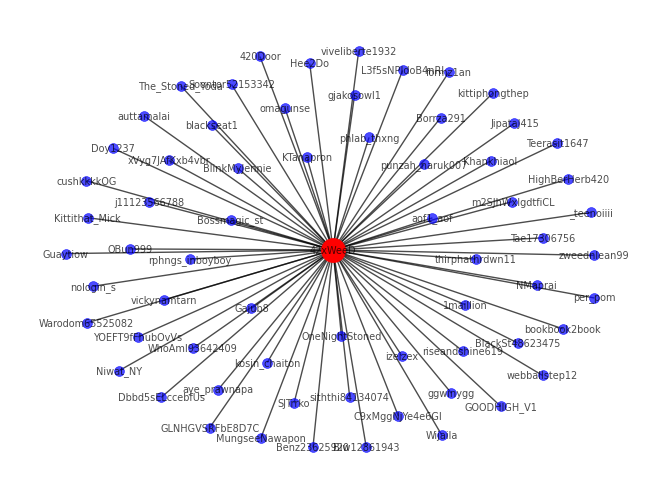

In [381]:
create_network(fol_df, '42xWeeD')

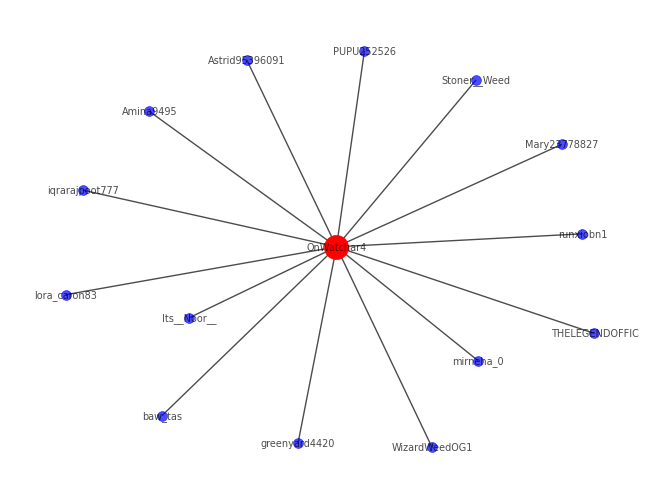

In [383]:
create_network(fol_df, 'OnWatchar4')

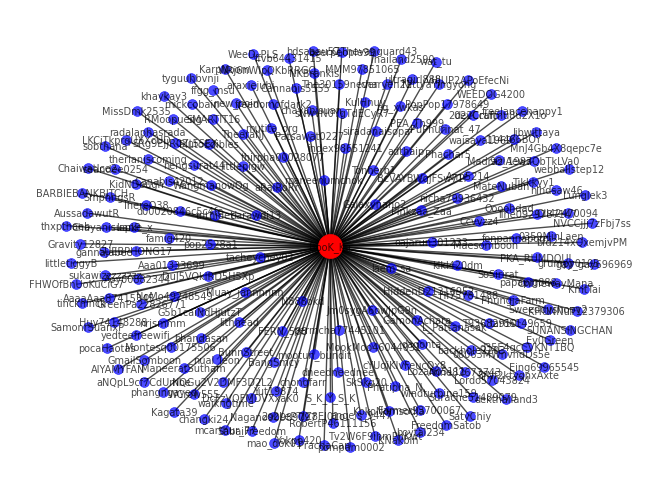

In [386]:
create_network(fol_df, 'BooK_Ku')

# Modeling

## Segment Users

In [806]:
# get number of follows for each follower 
source_df = pd.DataFrame(fol_df['source_name'].value_counts())
# create new dataframe with follower id and number of follows of that follower 
source_df = source_df.reset_index().set_axis(['source', 'follower_count'], axis=1, inplace=False)

In [807]:
def make_segment (value): 
    if value >= 200:
        return "200+"
    elif 200 > value >= 50 :
        return '50+'
    elif 50 > value >= 20 :
        return '20+'
    else :
        return '<10'

In [808]:
source_df['segment'] = source_df['follower_count'].apply(make_segment)

In [809]:
source_df

,source,follower_count,segment
0,Boy72323239,200,200+
1,greenyard4420,200,200+
2,ZC8EbZI8zsdKnGQ,200,200+
3,senelux1,200,200+
4,tntn60417683,200,200+
...,...,...,...
167,Lp9Ob,1,<10
168,cZ2uo91LnUvCNUy,1,<10
169,mickcobain,1,<10
170,fxckyahhh,1,<10


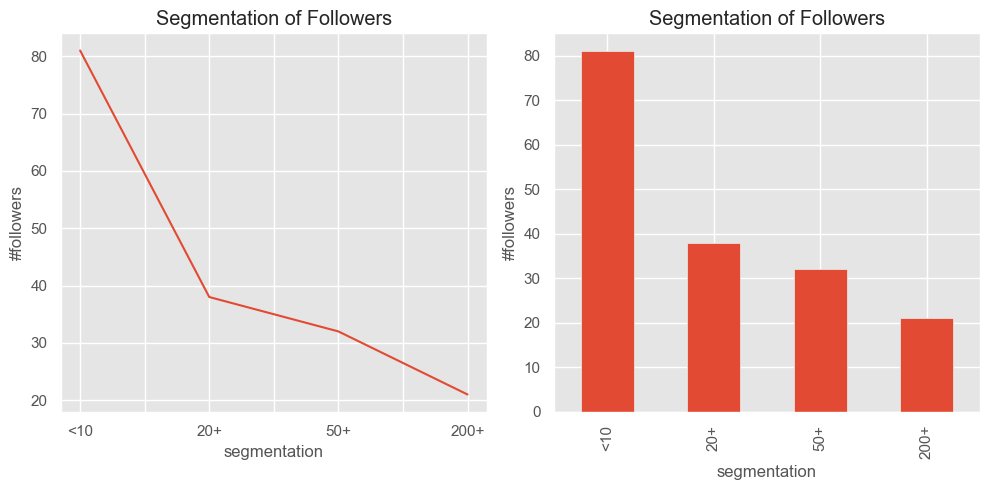

In [810]:
_, axes = plt.subplots(1,2, figsize=(10,5))

source_df['segment'].value_counts().plot(ax = axes[0]) ;
source_df['segment'].sort_index().value_counts().plot(kind = 'bar', ax = axes[1]) ; 

axes[0].set(xlabel="segmentation", ylabel="#followers") ;
axes[1].set(xlabel="segmentation", ylabel="#followers") ;

axes[0].set_title('Segmentation of Followers') ; 
axes[1].set_title('Segmentation of Followers');

axes[0].ticklabel_format(axis="y", style='plain')
axes[1].ticklabel_format(axis="y", style='plain')

plt.tight_layout()

### Similarity 

In [811]:
def jaccard_similarity(g, h):
    df_g=fol_df[fol_df["source_name"] == g][["source_name","follower_name"]]
    df_h=fol_df[fol_df["source_name"] == h][["source_name","follower_name"]]
    
    G=nx.from_pandas_edgelist(df_g, "source_name", "follower_name")
    H=nx.from_pandas_edgelist(df_h, "source_name", "follower_name")
    
    nb_g=list(nx.all_neighbors(G, g))
    nb_h=list(nx.all_neighbors(H, h))

    i = set(nb_g).intersection(nb_h)
    return round(len(i) / (len(nb_g) + len(nb_h) - len(i)), 3)

In [812]:
p1=source_df[source_df['segment']=='200+'].sample(1)['source']

In [813]:
p2=source_df[source_df['segment']=='200+'].sample(1)['source']

In [825]:
p1.values, p2.values

(array(['Abcdefghij3344'], dtype=object), array(['t_skyper'], dtype=object))

In [826]:
jaccard_similarity(p1.values[0],  p2.values[0])

0.003

In [833]:
top_seg=source_df[source_df['segment']=='200+']['source'].tolist()

In [835]:
result = []
for i in range(len(top_seg)):
    pointer = i
    for j in range(pointer+1, len(top_seg)):
        sim = jaccard_similarity(top_seg[i],top_seg[j])
        if sim > 0:
            result.append((sim, top_seg[i], top_seg[j]))

In [836]:
sim_df=pd.DataFrame(result, columns=['jacc_sim', 'p1', 'p2'])

In [837]:
sim_df.sort_values('jacc_sim', ascending=False)

,jacc_sim,p1,p2
52,0.136,Stoner__Weed,nkx8yf4PxV8RccU
21,0.130,ZC8EbZI8zsdKnGQ,Stoner__Weed
10,0.120,greenyard4420,Stoner__Weed
7,0.090,greenyard4420,ZC8EbZI8zsdKnGQ
28,0.078,ZC8EbZI8zsdKnGQ,nkx8yf4PxV8RccU
...,...,...,...
39,0.003,ptY9zKoTDLLhkOn,Stoner__Weed
1,0.003,Boy72323239,senelux1
41,0.003,ptY9zKoTDLLhkOn,Thailand2590
42,0.003,FreedomSatob,Stoner__Weed


#### Similarity of nodes 1

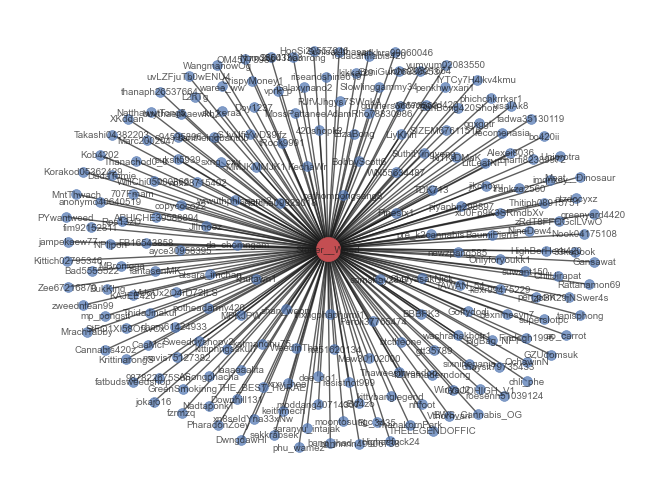

In [839]:
create_network(fol_df, 'Stoner__Weed')

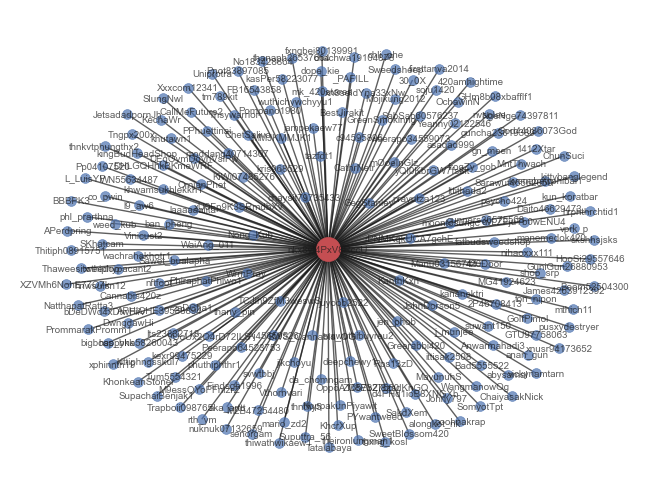

In [840]:
create_network(fol_df, 'nkx8yf4PxV8RccU')

## Centrality

In [863]:
G=nx.from_pandas_edgelist(fol_df, 'source_name', 'follower_name') 

In [864]:
degreeness = nx.degree_centrality(G)
deg_df=sorted(degreeness.items(), key=lambda x:x[1], reverse=True)

In [865]:
deg_df=pd.DataFrame(deg_df)[:50]

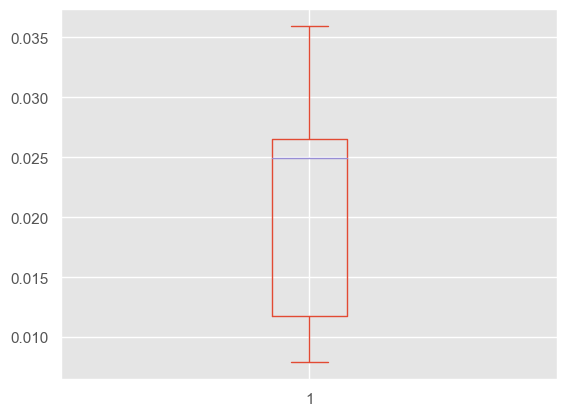

In [866]:
pd.DataFrame(deg_df).sort_index().plot(kind = 'box')
plt.show()

In [867]:
betweenness = nx.betweenness_centrality(G)
bet_df=sorted(betweenness.items(), key=lambda x:x[1], reverse=True)

In [868]:
bet_df=pd.DataFrame(bet_df)[:50]

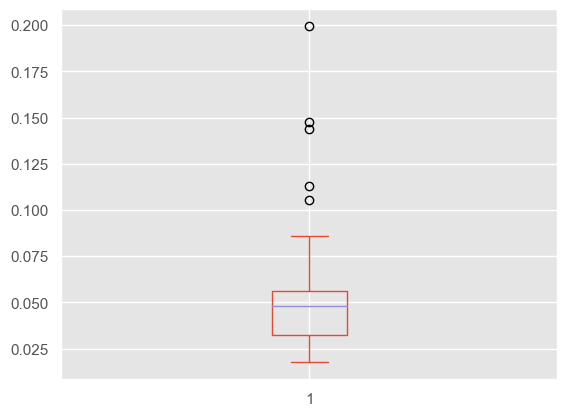

In [869]:
pd.DataFrame(bet_df).sort_index().plot(kind = 'box')
plt.show()

In [871]:
closeness = nx.closeness_centrality(G)
close_df=sorted(closeness.items(), key=lambda x:x[1], reverse=True)

In [872]:
close_df=pd.DataFrame(close_df)[:50]

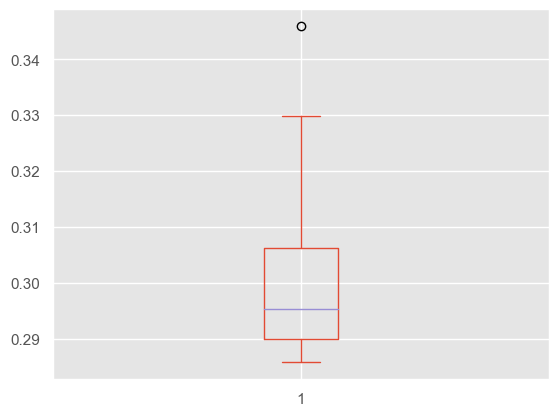

In [876]:
pd.DataFrame(close_df).sort_index().plot(kind = 'box')
plt.show()

In [890]:
eigenesss = nx.eigenvector_centrality(G)
eig_df=sorted(eigenesss.items(), key=lambda x:x[1], reverse=True)

In [891]:
eig_df=pd.DataFrame(eig_df)[:50]

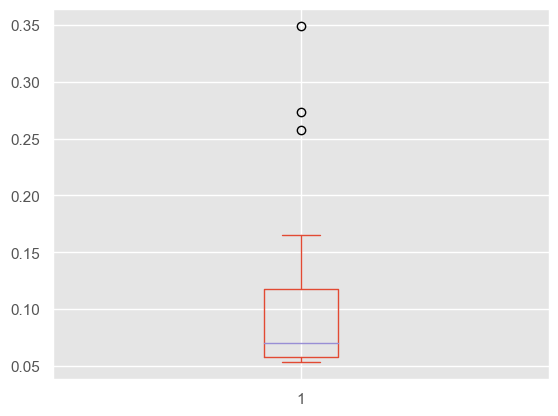

In [892]:
pd.DataFrame(eig_df).sort_index().plot(kind = 'box')
plt.show()

In [893]:
# top of all is 'greenyard4420'
deg_df.iloc[0][0], close_df.iloc[0][0], bet_df.iloc[0][0], eig_df.iloc[0][0]

('greenyard4420', 'greenyard4420', 'greenyard4420', 'greenyard4420')

## Community Detection

In [920]:
G=nx.from_pandas_edgelist(fol_df, 'source_name', 'follower_name') 

In [1162]:
# nx.transitivity(G)

In [936]:
position = nx.spring_layout(G)
partition = community_louvain.best_partition(G, random_state=12)
values = [partition.get(node) for node in G.nodes()]

In [ ]:
# https://python-louvain.readthedocs.io/en/latest/api.html
# Compute the partition of the graph nodes which maximises the modularity (or try..) using the Louvain heuristices
# This is the partition of highest modularity, i.e. the highest partition of the dendrogram generated by the Louvain algorithm.

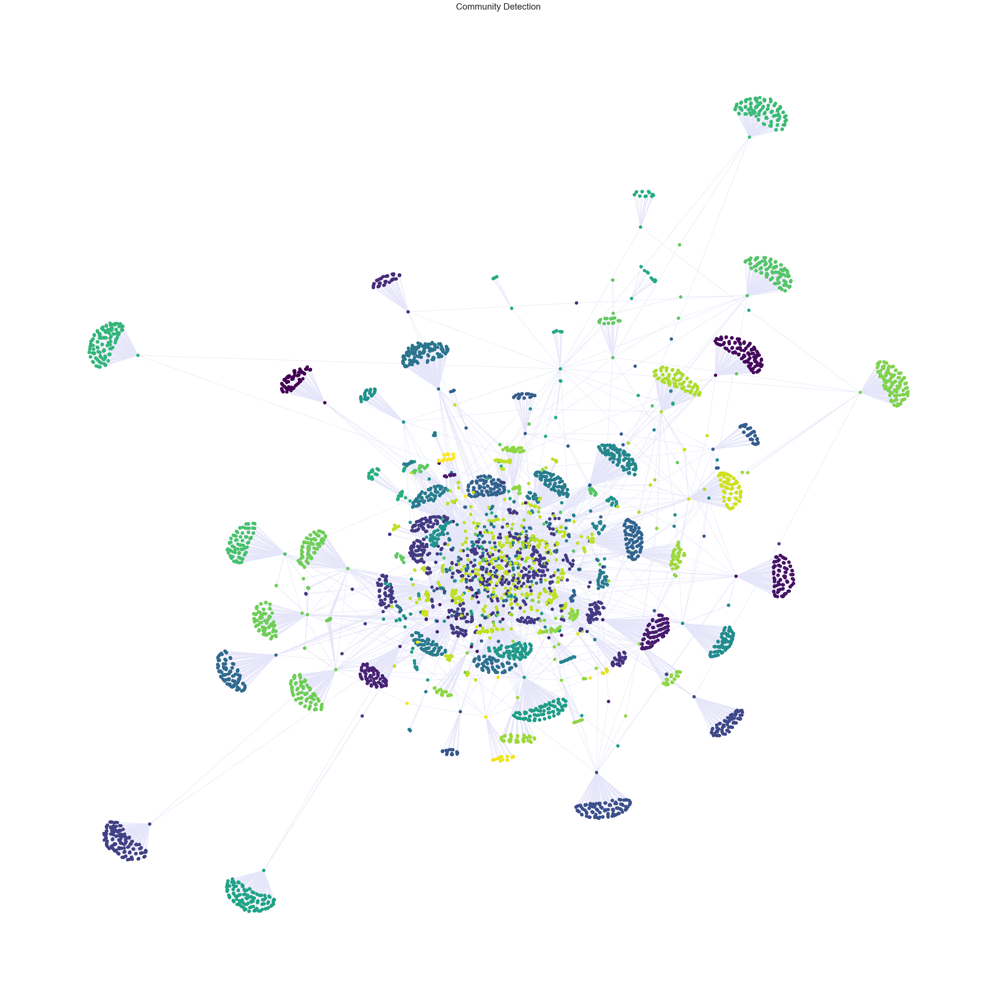

In [937]:
plt.figure(figsize=(40,40))
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx(G,
                 position,
                 cmap=cmap,
                 node_color=values, 
                 edge_color='lavender',
                 node_size=50, 
                 with_labels=False)
plt.title('Community Detection', size=20)
plt.axis('off')
plt.show()

In [946]:
len(sorted(set(values)))

42

In [938]:
commu_df=pd.DataFrame(partition.items(), columns=['account_name','commu'])

In [1031]:
commu_df.groupby('commu').count().reset_index().rename(columns={'account_name':'members'}).sort_values('members', ascending=False)[:10]

,commu,members
7,7,748
17,17,513
32,32,505
37,37,479
13,13,339
34,34,219
30,30,201
8,8,200
28,28,199
24,24,199


### Community Projection#1

In [1032]:
# project to community#7, 8
# recipocity, degree, transitivity, local-coefficient
# ลักษณะเฉพาะ, พฤติกรรม

In [1000]:
commu_df[commu_df['commu']==7].head()

,account_name,commu
9,nologin_s,7
21,vickynamtarn,7
26,GOODHIGH_V1,7
30,riseandshine619,7
37,OneNightStoned,7


In [1003]:
members=commu_df[commu_df['commu']==7]['account_name'].tolist()

In [1004]:
len(members)

748

In [1005]:
# 'greenyard4420' in members

In [1012]:
proj_df=fol_df[fol_df['source_name'].isin(members) | fol_df['follower_name'].isin(members)] 

In [1013]:
proj_df.head()

,source_id,source_name,follower_name,follower_id,location,description
8,1554768110963478528,42xWeeD,nologin_s,1527687522041872387,NaN,R
20,1554768110963478528,42xWeeD,vickynamtarn,1550589052227035136,Amphoe Mueang Nakhon Sawan,😊😍
25,1554768110963478528,42xWeeD,GOODHIGH_V1,1566827618426507264,NaN,"สนใจเข้ากลุ่ม ดอกคัดเกรดคุณภาพ หอม,สีตรงปก,กลิ่นตรงปก เกรด Excotic"
29,1554768110963478528,42xWeeD,riseandshine619,1383855774456107009,NaN,NaN
36,1554768110963478528,42xWeeD,OneNightStoned,1564506774572781568,"Bangkok, Thailand",We’d love to serve you the best weed in bkk. Feel free to contact me. กัญชาออร์แกนิค100% ส่งแมสทั่วกรุงเทพ สนใจ dm ห...


In [1014]:
CG=nx.from_pandas_edgelist(proj_df, 'source_name', 'follower_name') 

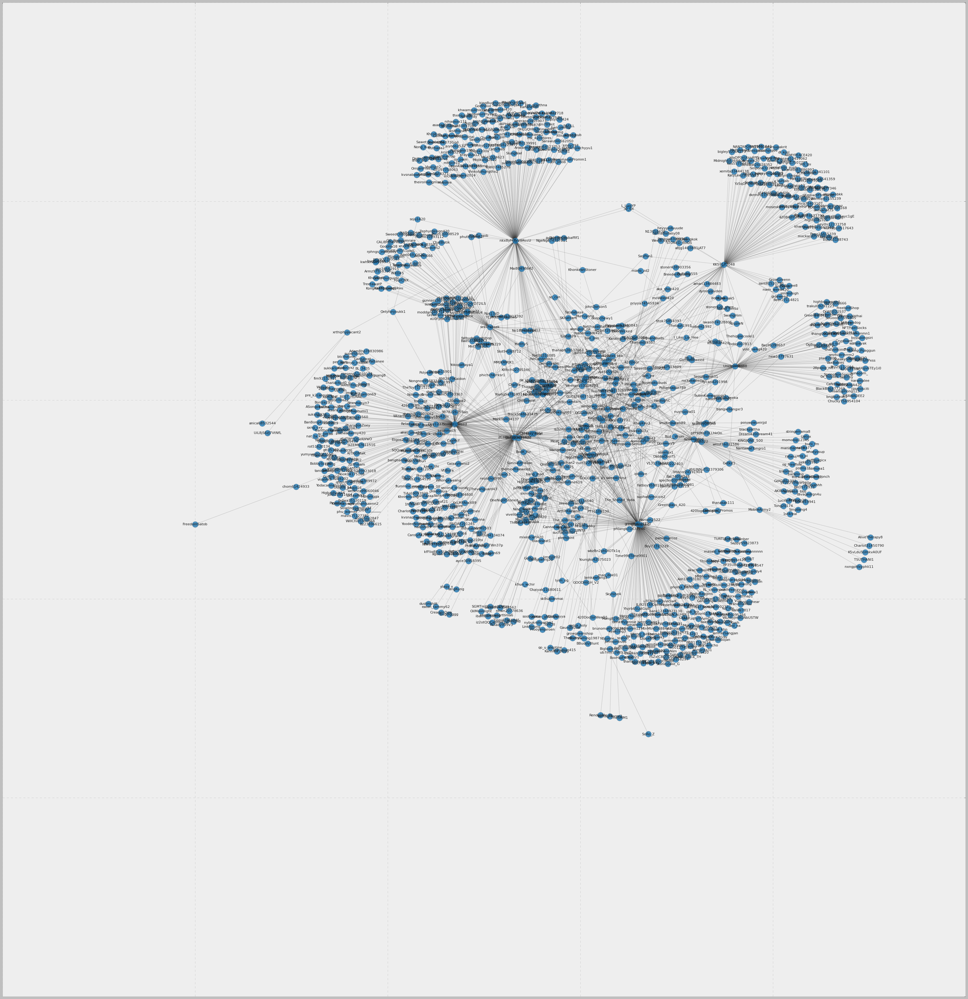

In [1015]:
pos = nx.spring_layout(CG) 
f, ax = plt.subplots(figsize=(50, 50))

nodes = nx.draw_networkx_nodes(CG, pos, alpha=0.8)

nodes.set_edgecolor('grey')
nx.draw_networkx_edges(CG, pos, width=1.0, alpha=0.2)
nx.draw_networkx_labels(CG, pos, font_size=10, font_color='k')
plt.show()

In [1018]:
# proj_df[proj_df['source_name'].str.contains('sup')]['source_name'].unique()
# df3[df3['account_name']=='suphathrmicice2']

array(['suphathrmicice2'], dtype=object)

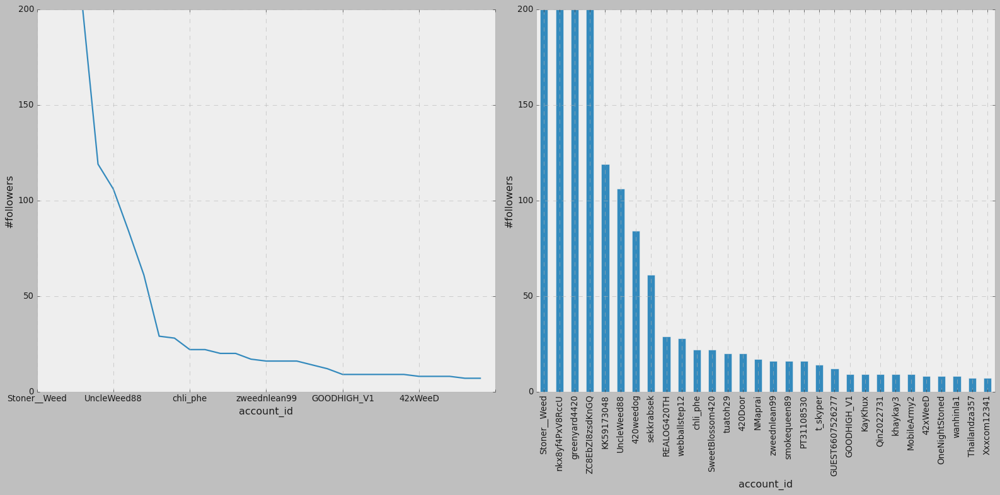

In [1030]:
_, axes = plt.subplots(1,2, figsize=(20,10))

plt.style.use('bmh')
proj_df['source_name'].sort_index().value_counts().iloc[:30].plot(ax = axes[0]) ;
proj_df['source_name'].sort_index().value_counts().iloc[:30].plot(kind = 'bar' , ax = axes[1]) ; 

axes[0].set(xlabel="account_id", ylabel="#followers") ;
axes[1].set(xlabel="account_id", ylabel="#followers") ;

plt.tight_layout()

In [1026]:
nx.reciprocity(CG), nx.transitivity(CG)

(0.0, 0.012260095659017981)

In [1029]:
sorted(nx.clustering(CG).items(), key=lambda x:x[1], reverse=True)[:10]

[('TCJlh9ZfM3weswS', 1.0),
 ('James4263912392', 1.0),
 ('Kasidis15369', 1.0),
 ('1zcBK29jNSwer4s', 1.0),
 ('Baimai97307219', 1.0),
 ('weedday42x', 1.0),
 ('thanasak111', 1.0),
 ('Bat74054248', 1.0),
 ('ptY9zKoTDLLhkOn', 1.0),
 ('yolo_sw4g420', 1.0)]

### Community Projection#2

In [1034]:
members=commu_df[commu_df['commu']==8]['account_name'].tolist()

In [1035]:
len(members)

200

In [1036]:
proj_df=fol_df[fol_df['source_name'].isin(members) | fol_df['follower_name'].isin(members)] 

In [1037]:
CG=nx.from_pandas_edgelist(proj_df, 'source_name', 'follower_name') 

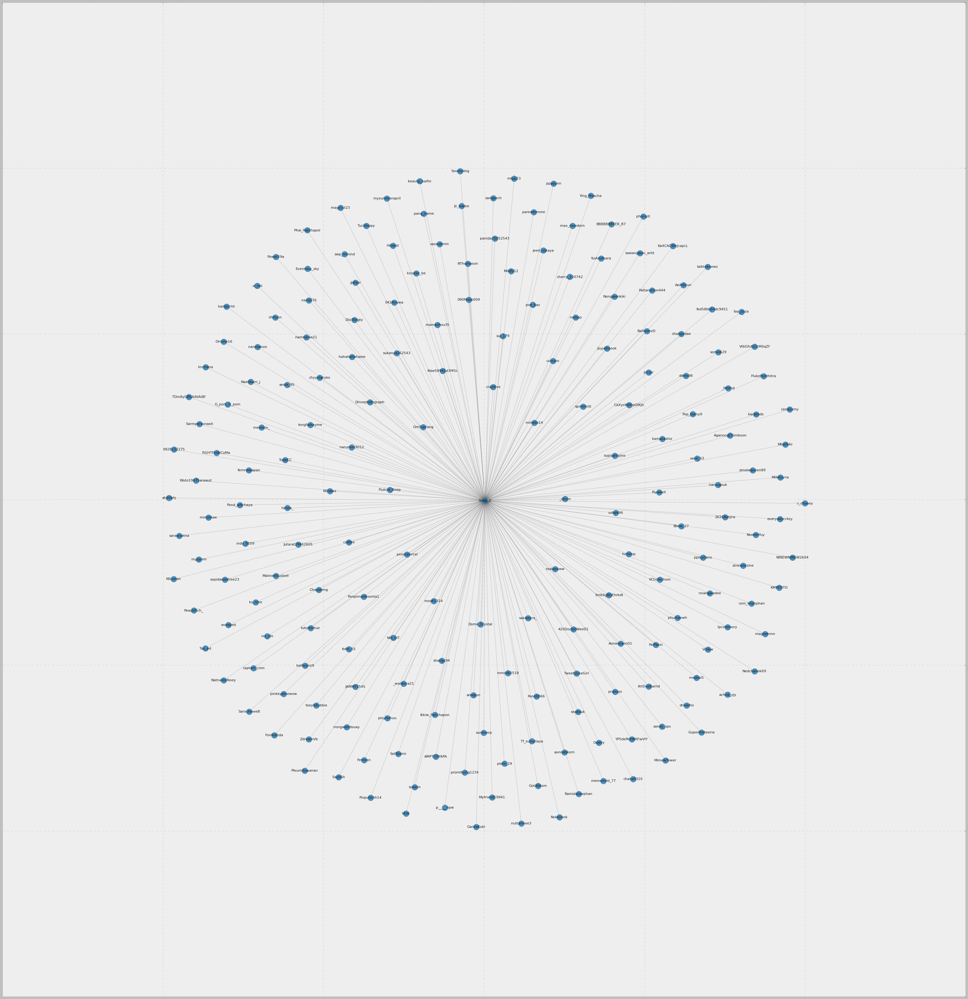

In [1038]:
pos = nx.spring_layout(CG) 
f, ax = plt.subplots(figsize=(50, 50))

nodes = nx.draw_networkx_nodes(CG, pos, alpha=0.8)

nodes.set_edgecolor('grey')
nx.draw_networkx_edges(CG, pos, width=1.0, alpha=0.2)
nx.draw_networkx_labels(CG, pos, font_size=10, font_color='k')
plt.show()

In [1042]:
name=proj_df[proj_df['source_name'].str.contains('So')]['source_name'].unique()[0]
df3[df3['account_name']==name]

,account_name,following_count,follower_count,abs_diff
5487,SoRo_Z,1.0,200.0,199.0


In [1051]:
# proj_df

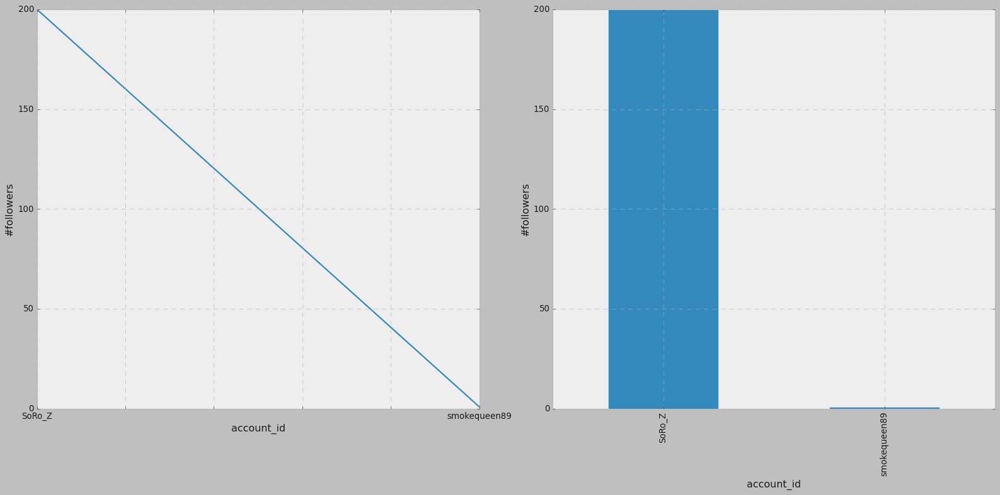

In [1047]:
_, axes = plt.subplots(1,2, figsize=(20,10))

plt.style.use('bmh')
proj_df['source_name'].sort_index().value_counts().plot(ax = axes[0]) ;
proj_df['source_name'].sort_index().value_counts().plot(kind = 'bar' , ax = axes[1]) ; 

axes[0].set(xlabel="account_id", ylabel="#followers") ;
axes[1].set(xlabel="account_id", ylabel="#followers") ;

plt.tight_layout()

In [1043]:
nx.reciprocity(CG), nx.transitivity(CG)

(0.0, 0)

In [1045]:
sorted(nx.clustering(CG).items(), key=lambda x:x[1], reverse=True)[:5]

[('smokequeen89', 0),
 ('SoRo_Z', 0),
 ('420DoctorWeeD1', 0),
 ('SoomoVog', 0),
 ('supisarapins', 0)]

## Location Visualization

In [1167]:
loc_df[['location']].head()

,location
3,"Bangkok, Thailand"
6,ประเทศไทย
10,Pathum
20,Amphoe Mueang Nakhon Sawan
22,LA


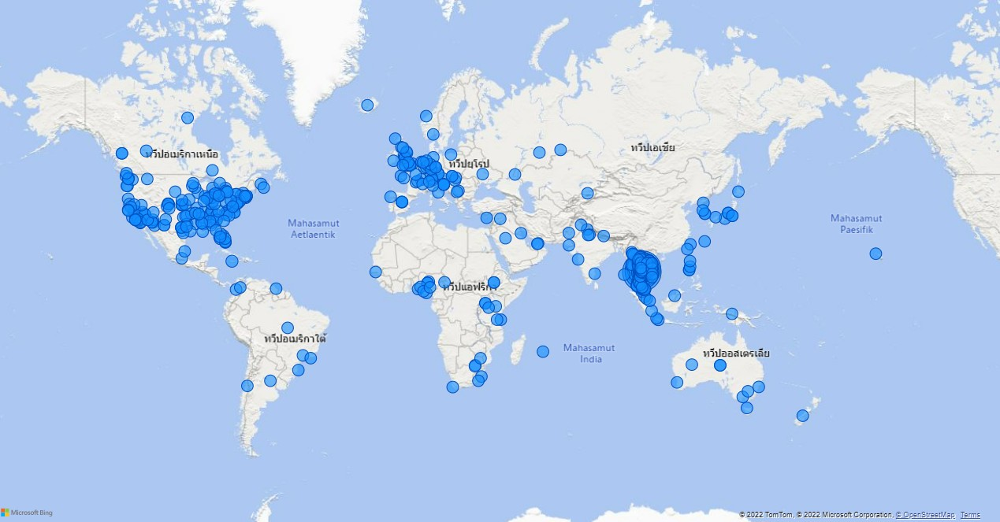

- Thailand Zoom

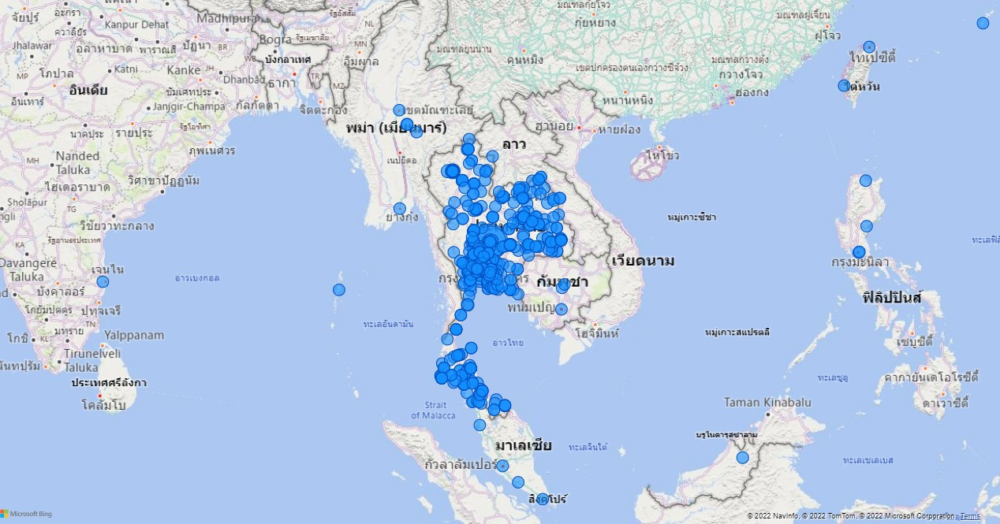

- Bangkok zoom

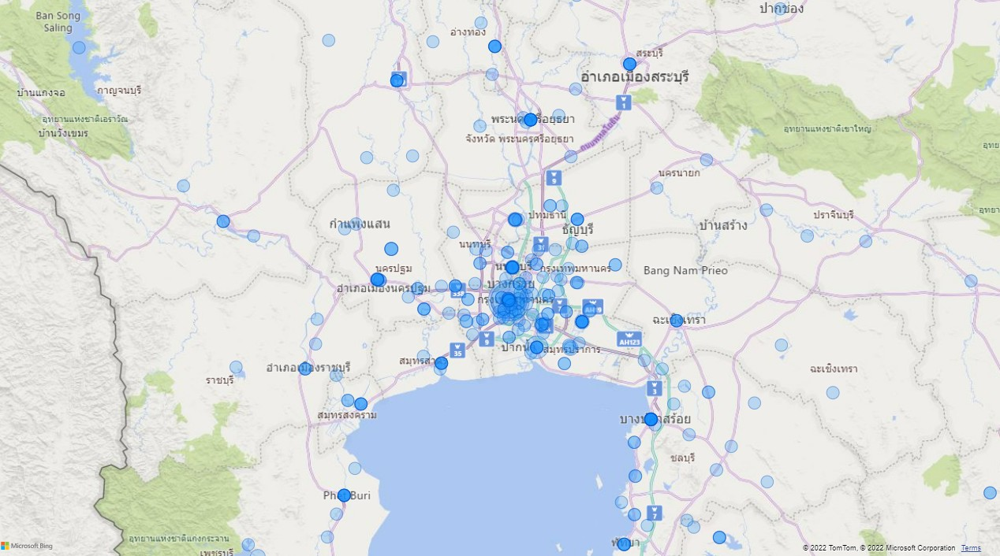

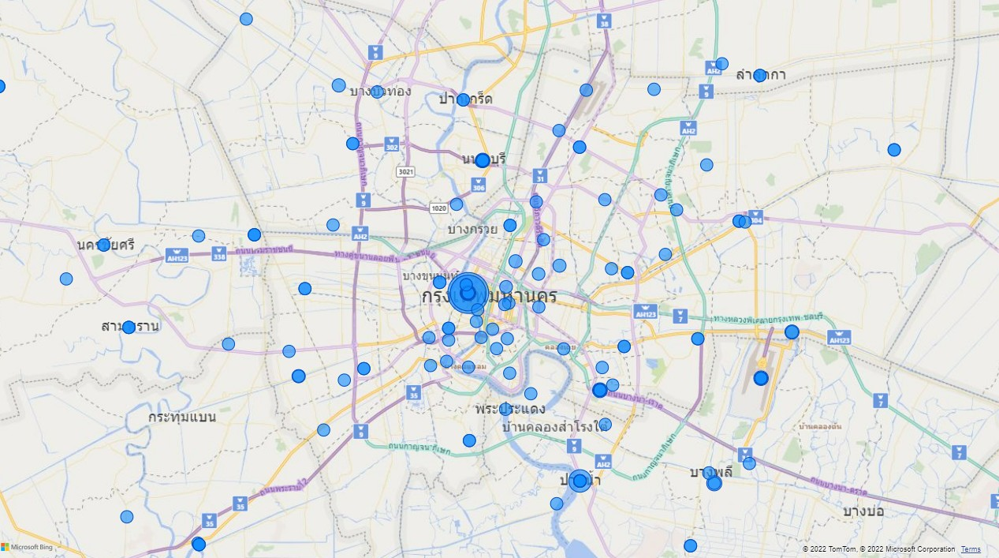

## Profile Clustering (from description)

In [1053]:
desc_df['description']

3                                                            Cannabis shop \nExotic, Top-shelf, mid-grade,low-grade\nส่ง+50฿
8                                                                                                                          R
16                                                                                                                 good byes
20                                                                                                                        😊😍
25                                                       สนใจเข้ากลุ่ม ดอกคัดเกรดคุณภาพ หอม,สีตรงปก,กลิ่นตรงปก  เกรด Excotic
                                                                ...                                                         
10182                                                   welcome to world of organic Cannabis  🌱💯 ยินดีต้อนรับสู่โลกของกัญ 🌱💯
10183         Cannabis OG 🧙‍♂️💚 กัญชาออแกนิค พันลำ , พันลำกลิ่นผลไม้ รังสิตชนมือได้&จัดส่ง Grab 🛵📦👉🏻 https://t.co/pKoPk7siVw


In [1095]:
txt_df=desc_df[['description']].copy()

In [1096]:
txt_df.head()

,description
3,"Cannabis shop \nExotic, Top-shelf, mid-grade,low-grade\nส่ง+50฿"
8,R
16,good byes
20,😊😍
25,"สนใจเข้ากลุ่ม ดอกคัดเกรดคุณภาพ หอม,สีตรงปก,กลิ่นตรงปก เกรด Excotic"


In [1083]:
import os
import math
import marisa_trie
import matplotlib
import matplotlib.font_manager as fm
import re
import texthero as hero

from wordcloud import WordCloud
from collections import Counter

from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer, HashingVectorizer
from sklearn.decomposition import PCA, LatentDirichletAllocation

from nltk.corpus import stopwords, words
from nltk.tokenize import word_tokenize, RegexpTokenizer
from nltk.stem import WordNetLemmatizer

from pythainlp.corpus import thai_stopwords 
from pythainlp.tokenize import word_tokenize
from pythainlp.corpus.common import thai_words
from pythainlp.util import normalize,isthai,isthaichar,find_keyword
from pythainlp import word_vector, sent_tokenize
from pythainlp.summarize import summarize

%matplotlib inline

In [1084]:
import nltk
nltk.download('wordnet')
nltk.download('words')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to /Users/prachy/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package words to /Users/prachy/nltk_data...
[nltk_data]   Package words is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /Users/prachy/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [1125]:
path = './THSarabunNew/THSarabunNew.ttf'
regexp = r"[ก-๙a-zA-Z']+"

In [1085]:
def change_matplotlib_font(font_download_url):
    FONT_PATH = 'MY_FONT'
    
    font_download_cmd = f"wget {font_download_url} -O {FONT_PATH}.zip"
    unzip_cmd = f"unzip -o {FONT_PATH}.zip -d {FONT_PATH}"
    os.system(font_download_cmd)
    os.system(unzip_cmd)
    
    font_files = fm.findSystemFonts(fontpaths=FONT_PATH)
    for font_file in font_files:
        fm.fontManager.addfont(font_file)

    font_name = fm.FontProperties(fname=font_files[0]).get_name()
    matplotlib.rc('font', family=font_name)
    print("font family: ", plt.rcParams['font.family'])

In [1086]:
font_download_url = "https://fonts.google.com/download?family=Noto%20Serif%20Thai"
change_matplotlib_font(font_download_url)

--2022-12-18 00:36:40--  https://fonts.google.com/download?family=Noto%20Serif%20Thai
Resolving fonts.google.com (fonts.google.com)... 2404:6800:4001:808::200e, 142.250.199.14
Connecting to fonts.google.com (fonts.google.com)|2404:6800:4001:808::200e|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/zip]
Saving to: ‘MY_FONT.zip’

     0K .......... .......... .......... .......... ..........  486K
    50K .......... .......... .......... .......... .......... 1.06M
   100K .......... .......... .......... .......... .......... 1.72M
   150K .......... .......... .......... .......... .......... 2.39M
   200K .......... .......... .......... .......... .......... 3.04M
   250K .......... .......... .......... .......... .......... 3.73M
   300K .......... .......... .......... .......... .......... 4.84M
   350K .......... .......... .......... .......... .......... 4.95M
   400K .......... .......... .......... .......... .......... 6.85

Archive:  MY_FONT.zip
  inflating: MY_FONT/OFL.txt         
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-Thin.ttf  
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-ExtraLight.ttf  
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-Light.ttf  
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-Regular.ttf  
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-Medium.ttf  
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-SemiBold.ttf  
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-Bold.ttf  
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-ExtraBold.ttf  
  inflating: MY_FONT/static/NotoSerifThai_ExtraCondensed/NotoSerifThai_ExtraCondensed-Black.ttf  
  inflating: MY_FONT/static/NotoSerifThai_Con

In [1087]:
pd.set_option('display.max_colwidth', None)

#### Text Cleasing

In [1088]:
def replace_url(text):
    URL_PATTERN = r"""(?i)\b((?:https?:(?:/{1,3}|[a-z0-9%])|[a-z0-9.\-]+[.](?:com|net|org|edu|gov|mil|aero|asia|biz|cat|coop|info|int|jobs|mobi|museum|name|post|pro|tel|travel|xxx|ac|ad|ae|af|ag|ai|al|am|an|ao|aq|ar|as|at|au|aw|ax|az|ba|bb|bd|be|bf|bg|bh|bi|bj|bm|bn|bo|br|bs|bt|bv|bw|by|bz|ca|cc|cd|cf|cg|ch|ci|ck|cl|cm|cn|co|cr|cs|cu|cv|cx|cy|cz|dd|de|dj|dk|dm|do|dz|ec|ee|eg|eh|er|es|et|eu|fi|fj|fk|fm|fo|fr|ga|gb|gd|ge|gf|gg|gh|gi|gl|gm|gn|gp|gq|gr|gs|gt|gu|gw|gy|hk|hm|hn|hr|ht|hu|id|ie|il|im|in|io|iq|ir|is|it|je|jm|jo|jp|ke|kg|kh|ki|km|kn|kp|kr|kw|ky|kz|la|lb|lc|li|lk|lr|ls|lt|lu|lv|ly|ma|mc|md|me|mg|mh|mk|ml|mm|mn|mo|mp|mq|mr|ms|mt|mu|mv|mw|mx|my|mz|na|nc|ne|nf|ng|ni|nl|no|np|nr|nu|nz|om|pa|pe|pf|pg|ph|pk|pl|pm|pn|pr|ps|pt|pw|py|qa|re|ro|rs|ru|rw|sa|sb|sc|sd|se|sg|sh|si|sj|Ja|sk|sl|sm|sn|so|sr|ss|st|su|sv|sx|sy|sz|tc|td|tf|tg|th|tj|tk|tl|tm|tn|to|tp|tr|tt|tv|tw|tz|ua|ug|uk|us|uy|uz|va|vc|ve|vg|vi|vn|vu|wf|ws|ye|yt|yu|za|zm|zw)/)(?:[^\s()<>{}\[\]]+|\([^\s()]*?\([^\s()]+\)[^\s()]*?\)|\([^\s]+?\))+(?:\([^\s()]*?\([^\s()]+\)[^\s()]*?\)|\([^\s]+?\)|[^\s`!()\[\]{};:'".,<>?«»“”‘’])|(?:(?<!@)[a-z0-9]+(?:[.\-][a-z0-9]+)*[.](?:com|net|org|edu|gov|mil|aero|asia|biz|cat|coop|info|int|jobs|mobi|museum|name|post|pro|tel|travel|xxx|ac|ad|ae|af|ag|ai|al|am|an|ao|aq|ar|as|at|au|aw|ax|az|ba|bb|bd|be|bf|bg|bh|bi|bj|bm|bn|bo|br|bs|bt|bv|bw|by|bz|ca|cc|cd|cf|cg|ch|ci|ck|cl|cm|cn|co|cr|cs|cu|cv|cx|cy|cz|dd|de|dj|dk|dm|do|dz|ec|ee|eg|eh|er|es|et|eu|fi|fj|fk|fm|fo|fr|ga|gb|gd|ge|gf|gg|gh|gi|gl|gm|gn|gp|gq|gr|gs|gt|gu|gw|gy|hk|hm|hn|hr|ht|hu|id|ie|il|im|in|io|iq|ir|is|it|je|jm|jo|jp|ke|kg|kh|ki|km|kn|kp|kr|kw|ky|kz|la|lb|lc|li|lk|lr|ls|lt|lu|lv|ly|ma|mc|md|me|mg|mh|mk|ml|mm|mn|mo|mp|mq|mr|ms|mt|mu|mv|mw|mx|my|mz|na|nc|ne|nf|ng|ni|nl|no|np|nr|nu|nz|om|pa|pe|pf|pg|ph|pk|pl|pm|pn|pr|ps|pt|pw|py|qa|re|ro|rs|ru|rw|sa|sb|sc|sd|se|sg|sh|si|sj|Ja|sk|sl|sm|sn|so|sr|ss|st|su|sv|sx|sy|sz|tc|td|tf|tg|th|tj|tk|tl|tm|tn|to|tp|tr|tt|tv|tw|tz|ua|ug|uk|us|uy|uz|va|vc|ve|vg|vi|vn|vu|wf|ws|ye|yt|yu|za|zm|zw)\b/?(?!@)))"""
    return re.sub(URL_PATTERN, 'xxurl', text)

def replace_special_char (text):
    special_char = r"""[~@<>,}{()*:;"'-+=_?"\"/$%^%$!ๆ‘’“”…่่่่่่่่่ạễ•′–0-9]"""
    text = re.sub(special_char, '', text)
    text = text.replace("[", '').replace("]", '').replace('-', '')
    return text

def remove_emoji(text):
    emoji_pattern = re.compile("["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
        u"\U0001F1F2-\U0001F1F4"  # Macau flag
        u"\U0001F1E6-\U0001F1FF"  # flags
        u"\U0001F600-\U0001F64F"
        u"\U00002702-\U000027B0"
        u"\U000024C2-\U0001F251"
        u"\U0001f926-\U0001f937"
        u"\U0001F1F2"
        u"\U0001F1F4"
        u"\U0001F620"
        u"\u200d"
        u"\u2640-\u2642"
        "]+", flags=re.UNICODE)

    return emoji_pattern.sub(r'', text)

def clean_text(text):
    text = text.lower().strip()
    text = replace_url(text)
    text = replace_special_char(text)
    text = remove_emoji(text)
    cleaned_text = normalize(text)

    return cleaned_text

#### More text cleaning

In [1089]:
added_words1 = ['ยกโล','ราคาส่ง','ครึ่งโล','กัญชาอัดแท่ง','งานดอกสายพันธุ์','มีของพร้อมส่งจริง','เนื้อล้วน']
added_words2 = ['ลอยกระทง','กัญชาอัดแทง','กัญชาเสรี','กัญชาการแพทย์','กัญชาออแกนิค','กลุ่ม','กัญชาทางการแพทย์','กัญชาไฟฟ้า','กัญชากรุงเทพ','การแพทย์','กัญชานอก','สายขียว']
added_words3 = ['กัญชาเชียงใหม','กัญชาขอนแกน','กัญชารามคําแหง','กัญชาลาดพร้าว','กัญชารามอินทรา','กัญชารังสิต','กัญชาออแกนิก','กัญชาอุบลราชธานี','กัญชารังสิต','กัญชานนทบุรี','กัญชาเมืองทอง','กัญชากรุงเทพ','กัญชานนทบุรี','กัญชาพัทยา','กัญชาลาดกระบัง','กัญชาบางนา','กัญชากทม','กัญชาราชบุรี','กัญชาลําพูน']
added_words4 = ['สุทิน','ศุภชัย','อนุทิน','ภูมิใจไทย','ประชาธิปัตย์','ภูมิใจไทย','พ.ร.บ.สุราก้าวหน้า','ก้าวไกล','จุรินทร์','สาทิตย์','นิพนธ์','หางกระรอก','หางเสือ','สุราก้าวหน้า','ฝายค้าน','อิหนู','หมอหนู']

punc1 = ['"','“','”','ๆ','!','-','\xa0•••',"‘",')','(','0','1','2','3','4','5','6','7','8','9','...','.','/',"’",':','%',"'",'#']
punc2 = ['\n','',' ', '⭐️' ,'?', '??','?‍♀️??‍♂️','❤️',':)','^ ^','^']
punc3 = ['✅','😡','@','✅✅', 'xxurl','🚨🚨','&gt;&gt;','🤤❤️‍🔥','✨ 🍰','🌞🍀','😅😅',
         '👉👉','❤️','��🏻','🤩🎉','💳','🥦','🍀✨','💯✅','💯','👇👇','👇','��',
        '🌳🔥😁','🔥','💯','️⃣️⃣ ️⃣️⃣️⃣','️⃣️⃣','✅✨','✅ ','🌱🌱','🛵📦']
pun4 = ['......','..','....','.....','......','.......','........','..........','.............','..............','.....................'] 

final_punc = set(punc1 + punc2 + punc3 + pun4)
final_added_words = set(added_words1 + added_words2 + added_words3 + added_words4)

#### Text processing

In [1090]:
all_words = set(thai_words()) 

for word in final_added_words:
    all_words.add(normalize(word))

c_dict = marisa_trie.Trie(all_words)

def cut_words(tweet):
    # atta-cut is default now
    tokens = word_tokenize(tweet, custom_dict=c_dict, keep_whitespace=False)
    tokens = [token for token in tokens if token not in final_punc]
    tokens = [token for token in tokens if token not in list(thai_stopwords())]
    tokens = [token for token in tokens if len(token) > 1]
    # tokens = [token if isthai(token) else token if token in words.words() else None for token in tokens]
    # tokens = [token for token in tokens if token is not None]
    return ' '.join(tokens)

def cut_more_words(tweet):
    tokens = word_tokenize(tweet, custom_dict=c_dict, keep_whitespace=False)
    tokens = [token for token in tokens if isthai(token)]
    tokens = [token for token in tokens if token[0] != '.']
    return ' '.join(tokens)
    
def extract_words(tweet):
    words = ''
    for token in tweet.split():
        if token[0] == '#':
            continue
        elif 'http' in token or 'www' in token:
            continue
        else:
            words += ' ' + cut_words(token)
        return words

In [1097]:
txt_df['clean'] = txt_df['description'].map(clean_text)

In [1101]:
txt_df['token'] = txt_df['clean'].map(cut_words)

In [1102]:
txt_df['clean_token'] = txt_df['token'].map(cut_more_words)

In [1112]:
txt_df=txt_df[txt_df['clean_token']!='']

In [1113]:
txt_df

,description,clean,token,clean_token
3,"Cannabis shop \nExotic, Top-shelf, mid-grade,low-grade\nส่ง+50฿",cannabis shop\nexotic topshelf midgradelowgrade\nสง฿,cannabis shop exotic topshelf midgradelowgrade สง,สง
25,"สนใจเข้ากลุ่ม ดอกคัดเกรดคุณภาพ หอม,สีตรงปก,กลิ่นตรงปก เกรด Excotic",สนใจเข้ากลุม ดอกคัดเกรดคุณภาพ หอมสีตรงปกกลินตรงปก เกรด excotic,สนใจ ลุ ดอก คัด เกรด คุณภาพ หอม สี ปก ลิ ปก เกรด excotic,สนใจ ลุ ดอก คัด เกรด คุณภาพ หอม สี ปก ลิ ปก เกรด
30,ขายกัญชา ไทย-นอกOG \nปลีกส่ง🔥\n\nline : @628upqba,ขายกัญชา ไทยนอกog\nปลีกสง\nline upqba,ขาย กัญชา ไทย og ปลีก สง line upqba,ขาย กัญชา ไทย ปลีก สง
32,ส่งปลอดภัยแน่นอน แจ้งวัฒนะ กทม 24 ชม. ถ้าไม่นอน #exotic #กัญชานอก บัญชีธนาคารกสิกร ลงท้ายด้วย4696เท่านั้น ไม่มีปลายทางนะครับย้ำ!!🔞ไม่ขายเด็กต่ำกว่า18ปีนะครับ,สงปลอดภัยแนนอน แจ้งวัฒนะ กทม ชม. ถ้าไมนอน #exotic #กัญชานอก บัญชีธนาคารกสิกร ลงท้ายด้วยเทานั้น ไมมีปลายทางนะครับย้ำไมขายเด็กตำกวาปีนะครับ,สง ปลอดภัย แนน อน แจ้ง วัฒนะ กทม ชม. ไม นอน exotic กัญชานอก บัญชี ธนาคาร กสิกร ลงท้าย เทา ไม ปลายทาง ย้ำ ไม ขาย เด็ก ตำ กวา ปี,สง ปลอดภัย แนน อน แจ้ง วัฒนะ กทม ชม. ไม นอน กัญชานอก บัญชี ธนาคาร กสิกร ลงท้าย เทา ไม ปลายทาง ย้ำ ไม ขาย เด็ก ตำ กวา ปี
33,อยุ่ขอนแก่นจ้าา,อยุขอนแกนจ้า,ยุ ขอน แกน,ยุ ขอน แกน
...,...,...,...,...
10178,รับนวด24ชม.คะ,รับนวดชม.คะ,นวด ชม.,นวด ชม.
10179,กัญชาสายพันธุ์นอกMid Grade Top Premiun รับประกันความเมา👾🤖👽 ส่งทั่วไทย🇹🇭 ส่งด่วนสมุทรปราการ🏍 เครดิตแน่น ทวิตเก่าโดนแบน เช็คเครดิตได้ 💚💚 🔞‼️ ขายปลีก-ส่ง,กัญชาสายพันธุ์นอกmid grade top premiun รับประกันความเมา🤖 สงทัวไทย สงดวนสมุทรปราการ เครดิตแนน ทวิตเกาโดนแบน เช็คเครดิตได้ ‼ ขายปลีกสง,กัญชา สายพันธุ์ mid grade top premiun รับประกัน ความเมา สง ทัว ไทย สง ดวน สมุทรปราการ เครดิต แนน ทวิ เกา โดน แบน เช็ค เครดิต ขายปลีก สง,กัญชา สายพันธุ์ รับประกัน ความเมา สง ทัว ไทย สง ดวน สมุทรปราการ เครดิต แนน ทวิ เกา โดน แบน เช็ค เครดิต ขายปลีก สง
10182,welcome to world of organic Cannabis 🌱💯 ยินดีต้อนรับสู่โลกของกัญ 🌱💯,welcome to world of organic cannabis ยินดีต้อนรับสูโลกของกัญ,welcome to world of organic cannabis ยินดีต้อนรับ สู โลก กัญ,ยินดีต้อนรับ สู โลก กัญ
10183,"Cannabis OG 🧙‍♂️💚 กัญชาออแกนิค พันลำ , พันลำกลิ่นผลไม้ รังสิตชนมือได้&จัดส่ง Grab 🛵📦👉🏻 https://t.co/pKoPk7siVw",cannabis og 🧙 กัญชาออแกนิค พันลำ พันลำกลินผลไม้ รังสิตชนมือได้&จัดสง grab xxurl,cannabis og กัญชาออแกนิค พันลำ พันลำ ลิ ผลไม้ รังสิต ชน มือ สง grab,กัญชาออแกนิค พันลำ พันลำ ลิ ผลไม้ รังสิต ชน มือ สง


In [1121]:
all_txt=[txt for txt in txt_df['clean_token']]

In [1123]:
all_txt=' '.join(all_txt)

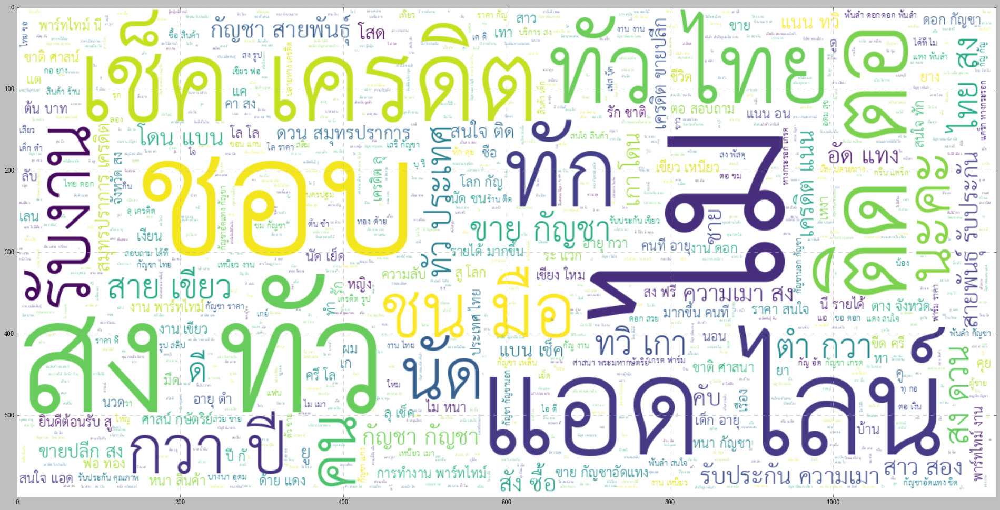

In [1136]:
wordcloud = WordCloud(font_path=path, 
                      relative_scaling=0.5,
                      max_font_size=120, 
                      max_words=3000, 
                      min_font_size=2,
                      background_color="white",
                      collocations=True,
                      scale=3,
                      font_step=3,
                      regexp=regexp,
                      margin=2).generate(all_txt)
plt.figure(figsize=(30,20))
plt.imshow(wordcloud, interpolation="bilinear")
plt.show()

In [1139]:
vectorizer = TfidfVectorizer(tokenizer=lambda x: x.split())
X = vectorizer.fit_transform(txt_df['clean_token'])

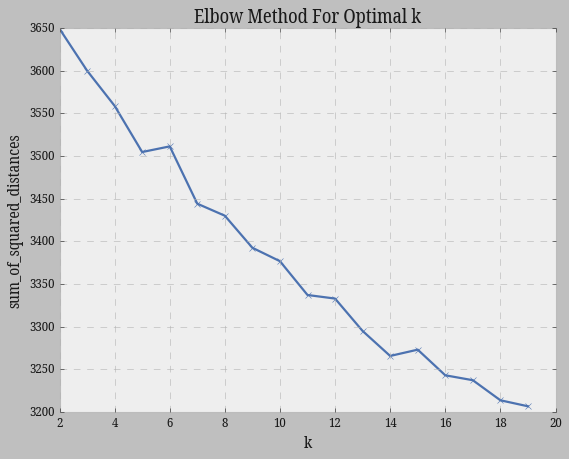

In [1140]:
err = []
start_k=2
max_k=20

for k in range(start_k, max_k):
    km = KMeans(n_clusters=k, max_iter=200, n_init=10).fit(X)
    err.append(km.inertia_)
    
plt.plot([i for i in range(start_k, max_k)], err, 'bx-')
plt.xlabel('k')
plt.ylabel('sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [1141]:
true_k=5
km=KMeans(n_clusters=true_k).fit(X)
c=km.cluster_centers_

In [1142]:
sorted(Counter(list(km.labels_)).most_common())

[(0, 2870), (1, 71), (2, 562), (3, 110), (4, 168)]

In [1154]:
cluster_df=pd.DataFrame({'cluster':km.labels_, 'txt':txt_df['clean_token']})

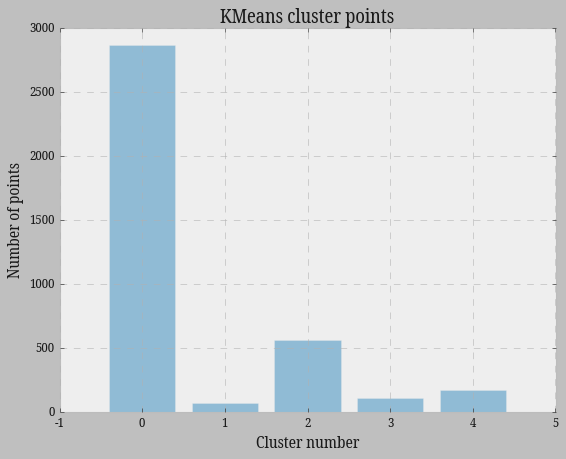

In [1157]:
# visually how data points distributed across K clusters 
plt.bar([x for x in range(true_k)], cluster_df.groupby(['cluster'])['txt'].count(), alpha = 0.5)
plt.title('KMeans cluster points')
plt.xlabel("Cluster number")
plt.ylabel("Number of points")
plt.show()

In [1158]:
# get centroid and order 
for i in range(true_k):
    print("cluster:#{}".format(i))
    word_tuples = [(c[i][j], vectorizer.get_feature_names_out()[j]) for j in range(len(c[i]))]
    word_tuples.sort(reverse=True)
    print(' '.join([str(j) for i,j in word_tuples[:10]]))
    print("-----")

cluster:#0
ไม ชอบ นัด สง รัก ทัก สาว คน กัญ ชาย
-----
cluster:#1
โสด เหงา ดด ทัก ดดดด ดดด ติด หา คน แฟน
-----
cluster:#2
กัญชา ไลน์ แอด ดอก ขาย สง สนใจ ลุ เขียว หนา
-----
cluster:#3
สง เครดิต ทัว ไทย ขายปลีก สมุทรปราการ แบน ดวน ความเมา โดน
-----
cluster:#4
พาร์ทไทม์ งาน ติด ตอ ปี อายุ กวา การทำงาน รายได้ มากขึ้น
-----


# Post Analysis 

In [499]:
# betweeness centrality and on real accounts investigation 

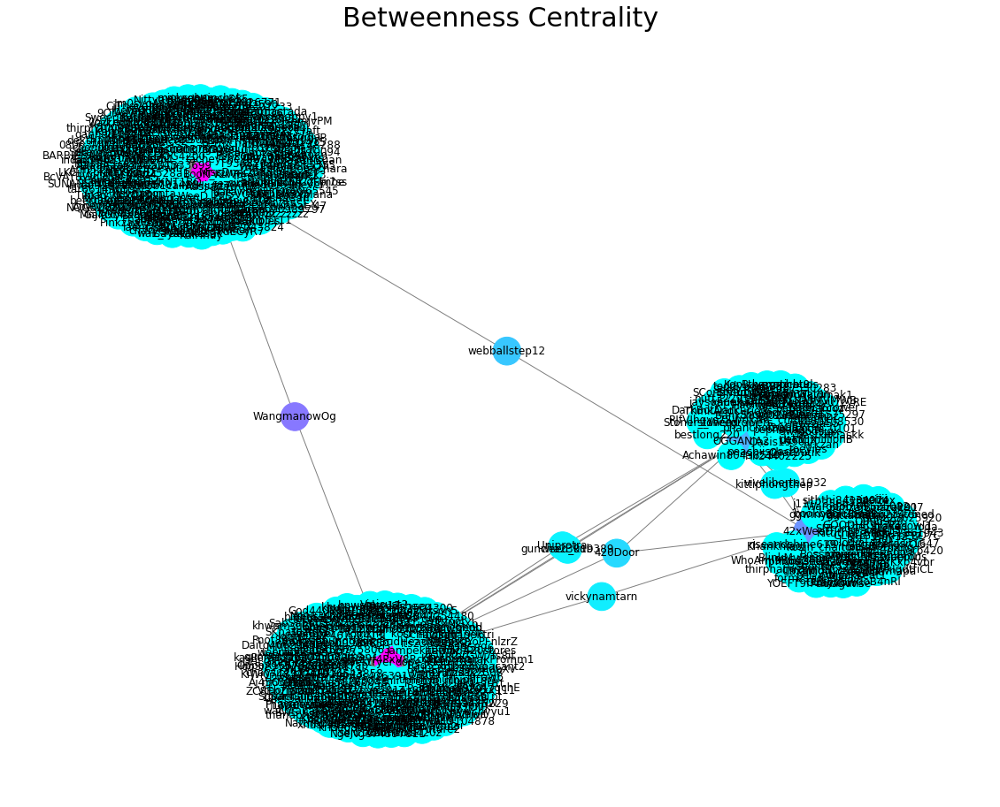

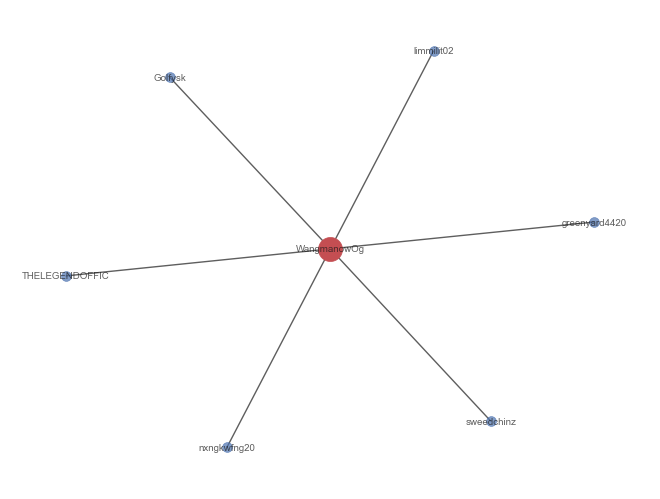

In [910]:
create_network(fol_df, 'WangmanowOg')

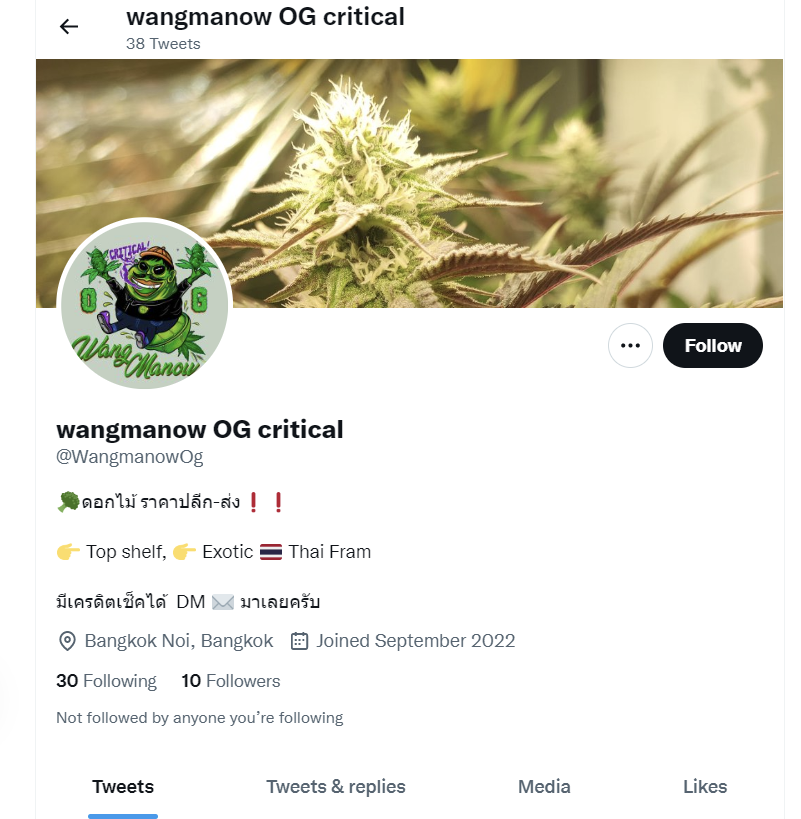

- มีผู้ติดตาม 30 บัญชี เป็นบัญชีที่มีการติดตามกลุ่มผู้ที่ขายกัญชารายที่มีการถูก Follower ที่สูงมากคือ BooK_Ku, nkx8yf4PxV8RccU, Mr.greenyard4420 และ SMOKINGOODSHOP เป็นต้น

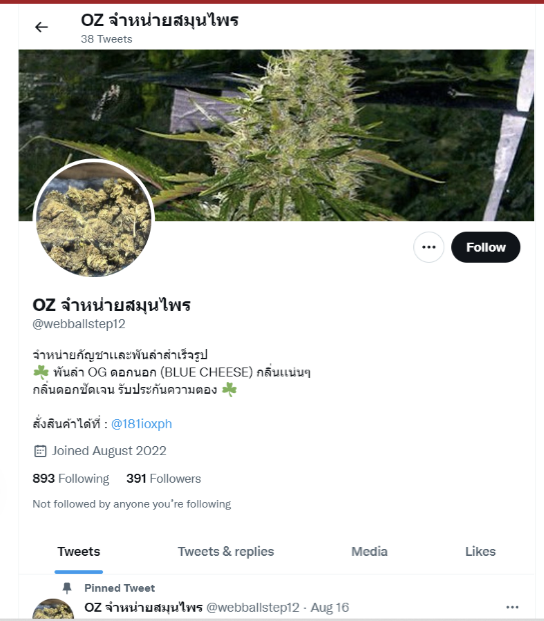

- มีผู้ติดตาม 391 บัญชี โดยมีผู้ติดตามที่เป็นผู้ขายกัญชารายอื่นจำนวนสูงมาก ๆ และมีทั้งผู้ที่สนใจจำนวนมากคอยติดตามน่าจะเป็นกลุ่มผู้ค้ารายใหญ่ที่มีความสัมพันธ์กันในเรื่องการขายส่ง


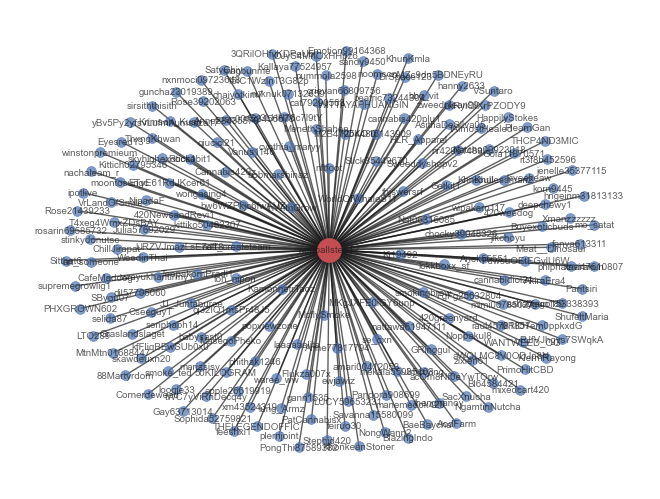

In [914]:
create_network(fol_df, 'webballstep12')

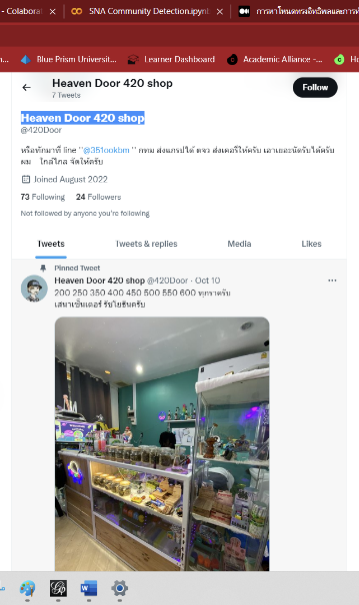

- @420Door  คือ ผู้ขายกัญชาที่มีหน้าร้านขายส่งเป็นทางการที่เสนาเซ็นเตอร์ รัชโยธิน มีการติดตามจากผู้ขายรายใหญ่ nkx8yf4PxV8RccU, ผู้ขายรายเล็ก  OGGANJA2, 42xWeeD

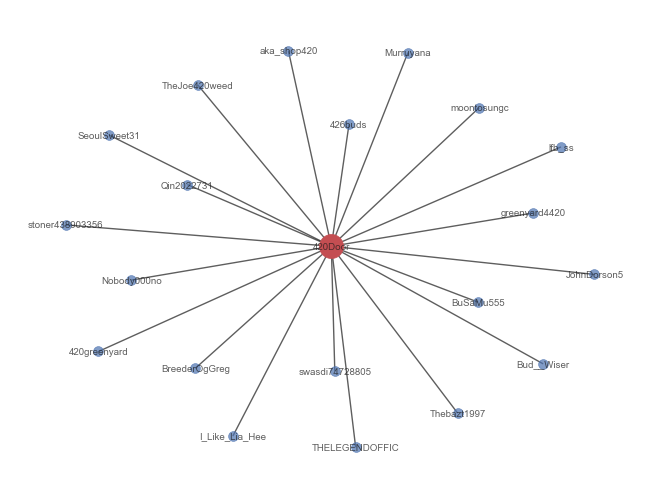

In [915]:
create_network(fol_df, '420Door')

### A BigOne of us

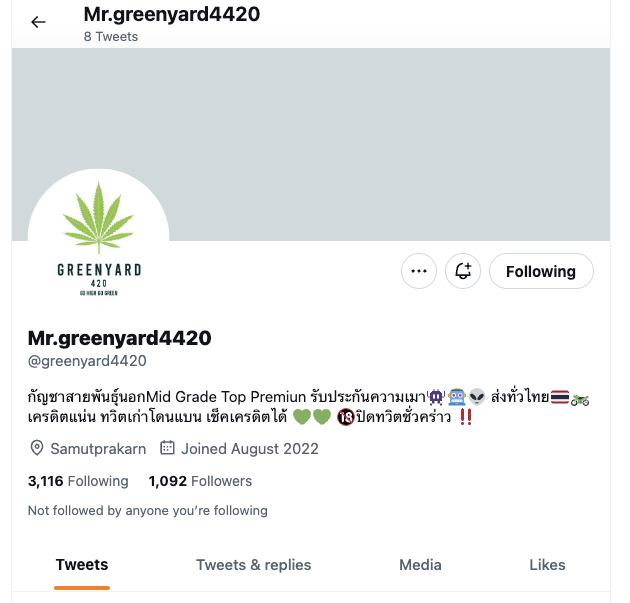

- **no tweet only retweet**

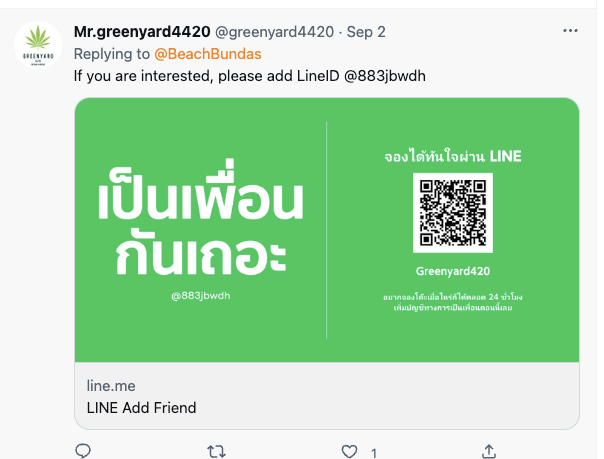